# Marginal Tax Rates in the UK

The current tax system is complex and applies different rates to different sources and sections of income. Earned income is taxed separately to capital income - but capital income is taxed on different rates dependent on the rates of the hypothetical combined income. Many elements of the tax code are filled with "do $X$ if this rule didn't exist", which make for complex and unintuitive resulting policies. But to start with the basics, here's the income tax paid on earned income:

In [1]:
def format_fig(plot, showlegend=False):
    plot.update_layout(font_family="Merriweather", font_color="black", plot_bgcolor="white", showlegend=showlegend)
    import plotly.io as pio
    pio.templates.default = 'plotly_white'
    return plot

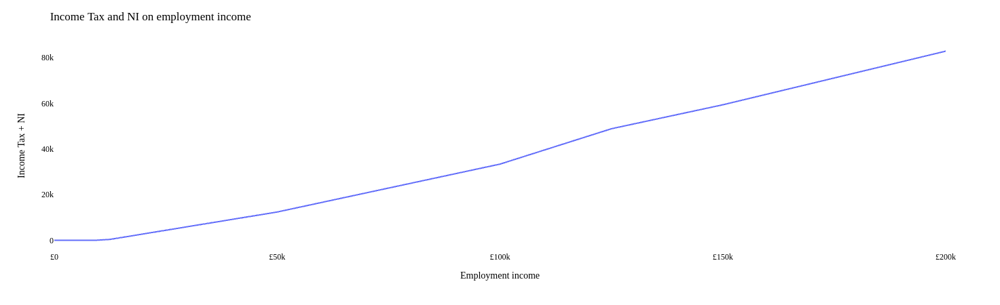

In [2]:
from openfisca_uk import IndividualSim
from plotly import express as px

sim = IndividualSim(year=2020)
sim.add_person(age=25)
sim.vary("employment_income")
fig = px.line(x=sim.calc("employment_income")[0], y=sim.calc("tax")[0])
fig.update_layout(title="Income Tax and NI on employment income", xaxis_title="Employment income", yaxis_title="Income Tax + NI", xaxis_tickprefix="£")
format_fig(fig).show()

And the derivative of this graph, the marginal tax rate by employment income:

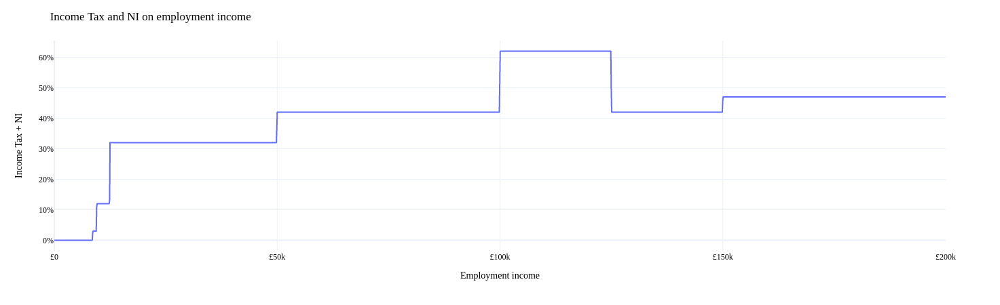

In [3]:
fig = px.line(x=sim.calc("employment_income")[0], y=sim.calc_deriv("tax"))
fig.update_layout(title="Income Tax and NI on employment income", xaxis_title="Employment income", yaxis_title="Income Tax + NI", yaxis_tickformat="%", xaxis_tickprefix="£")
format_fig(fig).show()

There's a few standout features here: primarily the nonsensical marginal tax rate of 60% on incomes between £100k and £125k. This is caused by withdrawal of the personal allowance, which happens entirely within this range. For every pound of income over £100k, a taxpayer's personal allowance decreases by 50p until it is zero. When this happens (a taxpayer with £100,000 increasing their income by £1), their income above the personal allowance increases by £1.50, which is taxed at the higher rate of 40%, amounting to 60p.

There's also the fact that this isn't nearly as progressive as the rates imply when they're described, because of how the taxes overlap. These are non-Scottish rates, which are slightly more progressive, but there is only one percentage point difference.

In [4]:
from openfisca_uk import Microsimulation

spi_sim = Microsimulation(mode="spi", year=2016)

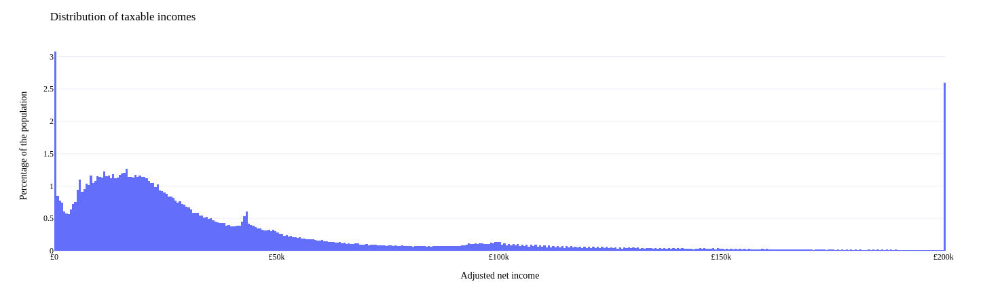

In [5]:
ANI = spi_sim.calc("adjusted_net_income")

fig = px.histogram(ANI.clip(0, 200000), histnorm='percent')
fig.update_layout(title="Distribution of taxable incomes", xaxis_title="Adjusted net income", yaxis_title="Percentage of the population", xaxis_tickprefix="£")
format_fig(fig).show()

Modelling notes: these results were produced using OpenFisca-UK with the Survey of Personal Incomes, a sample of HMRC tax records that generally has higher accuracy.